In [1]:
import pandas as pd
import numpy as np
import altair as alt
alt.renderers.enable("notebook")

RendererRegistry.enable('notebook')

In [2]:
df = pd.read_csv("claims.csv")

In [3]:
df

,Month,WeekOfMonth,DayOfWeek,Make,AccidentArea,DayOfWeekClaimed,MonthClaimed,WeekOfMonthClaimed,Sex,MaritalStatus,...,AgeOfVehicle,AgeOfPolicyHolder,PoliceReportFiled,WitnessPresent,AgentType,NumberOfSuppliments,AddressChange_Claim,NumberOfCars,Year,BasePolicy
0,Dec,5,Wednesday,Honda,Urban,Tuesday,Jan,1,Female,Single,...,3 years,26 to 30,No,No,External,none,1 year,3 to 4,1994,Liability
1,Jan,3,Wednesday,Honda,Urban,Monday,Jan,4,Male,Single,...,6 years,31 to 35,Yes,No,External,none,no change,1 vehicle,1994,Collision
2,Oct,5,Friday,Honda,Urban,Thursday,Nov,2,Male,Married,...,7 years,41 to 50,No,No,External,none,no change,1 vehicle,1994,Collision
3,Jun,2,Saturday,Toyota,Rural,Friday,Jul,1,Male,Married,...,more than 7,51 to 65,Yes,No,External,more than 5,no change,1 vehicle,1994,Liability
4,Jan,5,Monday,Honda,Urban,Tuesday,Feb,2,Female,Single,...,5 years,31 to 35,No,No,External,none,no change,1 vehicle,1994,Collision
5,Oct,4,Friday,Honda,Urban,Wednesday,Nov,1,Male,Single,...,5 years,21 to 25,No,No,External,3 to 5,no change,1 vehicle,1994,Collision
6,Feb,1,Saturday,Honda,Urban,Monday,Feb,3,Male,Married,...,7 years,36 to 40,No,No,External,1 to 2,no change,1 vehicle,1994,Collision
7,Nov,1,Friday,Honda,Urban,Tuesday,Mar,4,Male,Single,...,new,16 to 17,No,No,External,none,no change,1 vehicle,1994,Collision
8,Dec,4,Saturday,Honda,Urban,Wednesday,Dec,5,Male,Single,...,6 years,31 to 35,No,Yes,External,3 to 5,no change,1 vehicle,1994,Collision
9,Apr,3,Tuesday,Ford,Urban,Wednesday,Apr,3,Male,Married,...,more than 7,36 to 40,No,No,External,3 to 5,no change,1 vehicle,1994,All Perils


In [4]:
df.columns

Index(['Month', 'WeekOfMonth', 'DayOfWeek', 'Make', 'AccidentArea',
       'DayOfWeekClaimed', 'MonthClaimed', 'WeekOfMonthClaimed', 'Sex',
       'MaritalStatus', 'Age', 'Fault', 'PolicyType', 'VehicleCategory',
       'VehiclePrice', 'FraudFound_P', 'PolicyNumber', 'RepNumber',
       'Deductible', 'DriverRating', 'Days_Policy_Accident',
       'Days_Policy_Claim', 'PastNumberOfClaims', 'AgeOfVehicle',
       'AgeOfPolicyHolder', 'PoliceReportFiled', 'WitnessPresent', 'AgentType',
       'NumberOfSuppliments', 'AddressChange_Claim', 'NumberOfCars', 'Year',
       'BasePolicy'],
      dtype='object')

### Missing Value Analysis

In [5]:
df.isnull().sum().sort_values(ascending=False)

BasePolicy              0
FraudFound_P            0
WeekOfMonth             0
DayOfWeek               0
Make                    0
AccidentArea            0
DayOfWeekClaimed        0
MonthClaimed            0
WeekOfMonthClaimed      0
Sex                     0
MaritalStatus           0
Age                     0
Fault                   0
PolicyType              0
VehicleCategory         0
VehiclePrice            0
PolicyNumber            0
Year                    0
RepNumber               0
Deductible              0
DriverRating            0
Days_Policy_Accident    0
Days_Policy_Claim       0
PastNumberOfClaims      0
AgeOfVehicle            0
AgeOfPolicyHolder       0
PoliceReportFiled       0
WitnessPresent          0
AgentType               0
NumberOfSuppliments     0
AddressChange_Claim     0
NumberOfCars            0
Month                   0
dtype: int64

In [6]:
# We can see that the dataset contains no missing values

# Exploratory Data Ananlysis

In [7]:
# Creating a dataframe with only fraud data
fraud = df['FraudFound_P']==1
df_fraud = df[fraud]

In [8]:
df_fraud

,Month,WeekOfMonth,DayOfWeek,Make,AccidentArea,DayOfWeekClaimed,MonthClaimed,WeekOfMonthClaimed,Sex,MaritalStatus,...,AgeOfVehicle,AgeOfPolicyHolder,PoliceReportFiled,WitnessPresent,AgentType,NumberOfSuppliments,AddressChange_Claim,NumberOfCars,Year,BasePolicy
28,Jul,1,Saturday,Honda,Urban,Tuesday,Sep,4,Male,Single,...,new,16 to 17,No,No,External,none,no change,1 vehicle,1994,All Perils
52,Jul,3,Sunday,Honda,Rural,Wednesday,Jan,4,Male,Married,...,4 years,26 to 30,No,No,External,3 to 5,no change,1 vehicle,1994,Collision
53,Jul,4,Saturday,Honda,Urban,Wednesday,Aug,2,Male,Married,...,more than 7,41 to 50,No,No,External,3 to 5,no change,1 vehicle,1994,Collision
94,Nov,2,Thursday,Honda,Urban,Friday,Jan,3,Male,Single,...,7 years,31 to 35,No,No,External,3 to 5,no change,1 vehicle,1994,Collision
96,Nov,2,Friday,Toyota,Urban,Tuesday,Jan,1,Male,Married,...,7 years,36 to 40,No,No,External,none,no change,1 vehicle,1994,Collision
100,Nov,3,Tuesday,Chevrolet,Urban,Wednesday,Jan,2,Male,Married,...,7 years,31 to 35,No,No,External,more than 5,no change,1 vehicle,1994,All Perils
113,Nov,4,Thursday,Accura,Rural,Tuesday,Jan,2,Male,Married,...,more than 7,51 to 65,No,No,External,none,no change,1 vehicle,1994,All Perils
118,Nov,5,Monday,Mazda,Urban,Wednesday,Dec,1,Male,Single,...,5 years,over 65,No,No,External,none,no change,1 vehicle,1994,All Perils
119,Dec,1,Friday,Honda,Rural,Friday,Dec,3,Male,Single,...,new,16 to 17,No,No,External,none,no change,1 vehicle,1994,All Perils
147,Dec,1,Monday,Toyota,Rural,Tuesday,May,3,Male,Married,...,more than 7,36 to 40,No,No,External,more than 5,under 6 months,2 vehicles,1994,All Perils


### Analysis of Incident Related Factors

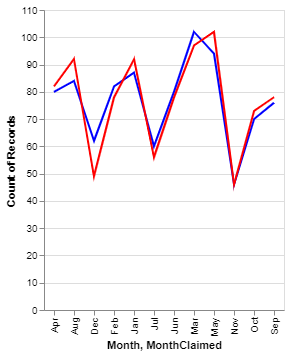

In [9]:
base = alt.Chart(df_fraud).encode(y='count()')

alt.layer(
    base.mark_line(color='blue').encode(x='Month'),
    base.mark_line(color='red').encode(x='MonthClaimed')
)

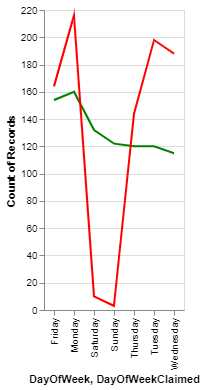

In [10]:
base = alt.Chart(df_fraud).encode(y='count()')

alt.layer(
    base.mark_line(color='green').encode(x='DayOfWeek'),
    base.mark_line(color='red').encode(x='DayOfWeekClaimed')
)

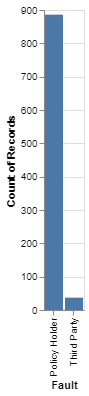

In [11]:
alt.Chart(df_fraud).mark_bar().encode(
    alt.X("Fault"),
    y='count()',
    
)

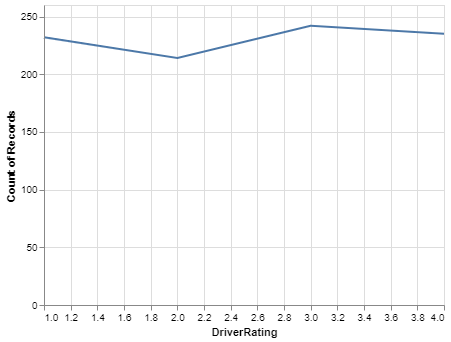

In [12]:
alt.Chart(df_fraud).mark_line().encode(
    alt.X("DriverRating"),
    y='count()',
    
)

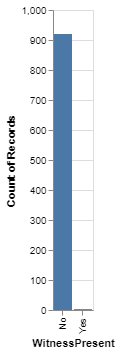

In [13]:
alt.Chart(df_fraud).mark_bar().encode(
    alt.X("WitnessPresent"),
    y='count()',
    
)

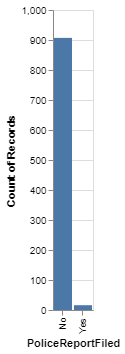

In [14]:
alt.Chart(df_fraud).mark_bar().encode(
    alt.X("PoliceReportFiled"),
    y='count()',
    
)

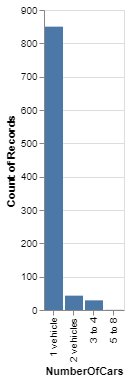

In [15]:
alt.Chart(df_fraud).mark_bar().encode(
    alt.X("NumberOfCars"),
    y='count()',
    
)

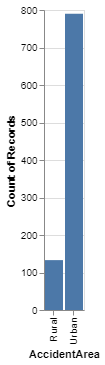

In [16]:
alt.Chart(df_fraud).mark_bar().encode(
    alt.X("AccidentArea"),
    y='count()',
    
)

### Analysis of Policy Related Factors

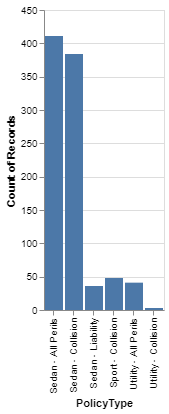

In [17]:
alt.Chart(df_fraud).mark_bar().encode(
    alt.X("PolicyType"),
    y='count()',
    
)

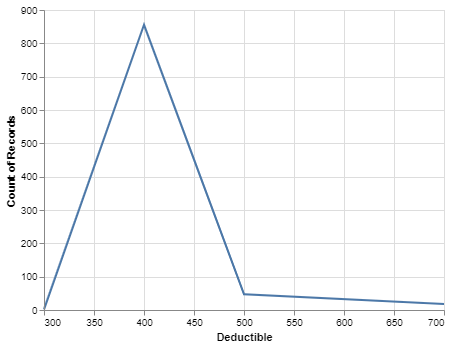

In [18]:
alt.Chart(df_fraud).mark_line().encode(
    alt.X("Deductible"),
    y='count()',
    
)

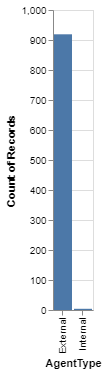

In [19]:
alt.Chart(df_fraud).mark_bar().encode(
    alt.X("AgentType"),
    y='count()',
    
)

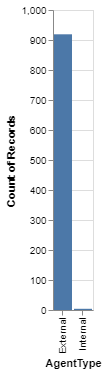

In [20]:
alt.Chart(df_fraud).mark_bar().encode(
    alt.X("AgentType"),
    y='count()',
    
)

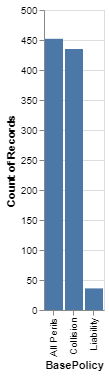

In [21]:
alt.Chart(df_fraud).mark_bar().encode(
    alt.X("BasePolicy"),
    y='count()',
    
)

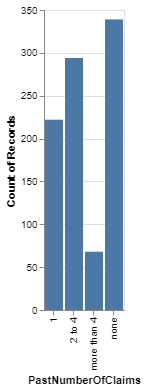

In [22]:
alt.Chart(df_fraud).mark_bar().encode(
    alt.X("PastNumberOfClaims"),
    y='count()',
    
)

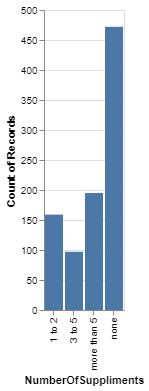

In [23]:
alt.Chart(df_fraud).mark_bar().encode(
    alt.X("NumberOfSuppliments"),
    y='count()',
    
)

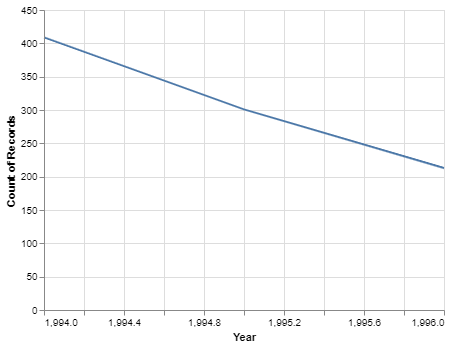

In [24]:
alt.Chart(df_fraud).mark_line().encode(
    alt.X("Year"),
    y='count()',
    
)

### Analysis of Vehicle Related factors

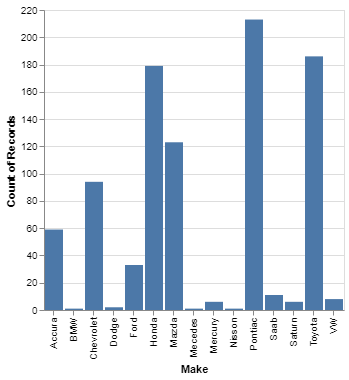

In [25]:
alt.Chart(df_fraud).mark_bar().encode(
    alt.X("Make"),
    y='count()',
    
)

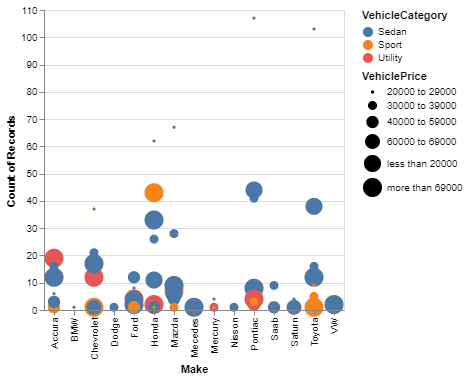

In [26]:
alt.Chart(df_fraud).mark_circle().encode(
    alt.X('Make', scale=alt.Scale(zero=False)),
    alt.Y('count()', scale=alt.Scale(zero=False)),
    color='VehicleCategory',
    size='VehiclePrice'
)

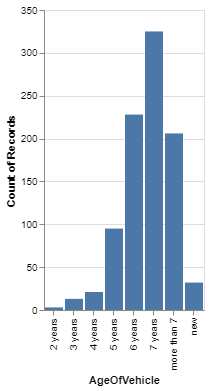

In [27]:
alt.Chart(df_fraud).mark_bar().encode(
    alt.X("AgeOfVehicle"),
    y='count()',
    
)

### Analysis of Social Factors

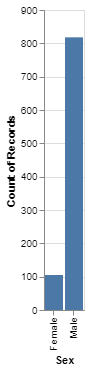

In [28]:
alt.Chart(df_fraud).mark_bar().encode(
    alt.X("Sex"),
    y='count()',
    
)

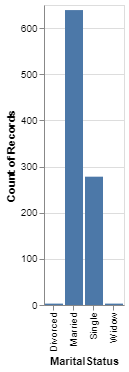

In [29]:
alt.Chart(df_fraud).mark_bar().encode(
    alt.X("MaritalStatus"),
    y='count()',
    
)

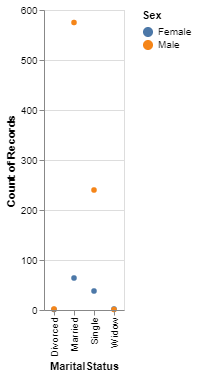

In [30]:
alt.Chart(df_fraud).mark_circle().encode(
    alt.X('MaritalStatus', scale=alt.Scale(zero=False)),
    alt.Y('count()', scale=alt.Scale(zero=False)),
    color='Sex'
)

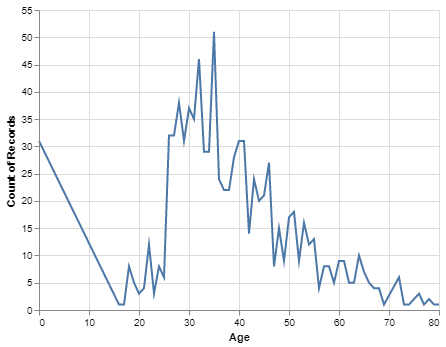

In [31]:
alt.Chart(df_fraud).mark_line().encode(
    alt.X("Age"),
    y='count()',
    
)

# Feature Engineering

### Replacing 0 values in 'Age' column

In [32]:
# Age column has a lot of 0 values. As age cannot be zero, it must be imouted with a suitable value
# Convertaing to nan in order to make it easier to do imputation
df.loc[df['Age'] == 0,'Age'] = np.nan

In [33]:
# Imputing nan with kNN imputer
from missingpy import KNNImputer
imputer = KNNImputer()
df['Age'] = imputer.fit_transform(np.array(df['Age']).reshape(-1,1))

C:\Users\maila\Anaconda3\lib\site-packages\missingpy\knnimpute.py:224: UserWarning: There are rows with more than 50.0% missing values. These rows are not included as donor neighbors.
  .format(self.row_max_missing * 100))
C:\Users\maila\Anaconda3\lib\site-packages\missingpy\knnimpute.py:282: UserWarning: There are rows with more than 50.0% missing values. The missing features in these rows are imputed with column means.
  .format(self.row_max_missing * 100))


### Encoding categorical variables to numeric

In [34]:
df.select_dtypes(include=['object'])

,Month,DayOfWeek,Make,AccidentArea,DayOfWeekClaimed,MonthClaimed,Sex,MaritalStatus,Fault,PolicyType,...,PastNumberOfClaims,AgeOfVehicle,AgeOfPolicyHolder,PoliceReportFiled,WitnessPresent,AgentType,NumberOfSuppliments,AddressChange_Claim,NumberOfCars,BasePolicy
0,Dec,Wednesday,Honda,Urban,Tuesday,Jan,Female,Single,Policy Holder,Sport - Liability,...,none,3 years,26 to 30,No,No,External,none,1 year,3 to 4,Liability
1,Jan,Wednesday,Honda,Urban,Monday,Jan,Male,Single,Policy Holder,Sport - Collision,...,none,6 years,31 to 35,Yes,No,External,none,no change,1 vehicle,Collision
2,Oct,Friday,Honda,Urban,Thursday,Nov,Male,Married,Policy Holder,Sport - Collision,...,1,7 years,41 to 50,No,No,External,none,no change,1 vehicle,Collision
3,Jun,Saturday,Toyota,Rural,Friday,Jul,Male,Married,Third Party,Sedan - Liability,...,1,more than 7,51 to 65,Yes,No,External,more than 5,no change,1 vehicle,Liability
4,Jan,Monday,Honda,Urban,Tuesday,Feb,Female,Single,Third Party,Sport - Collision,...,none,5 years,31 to 35,No,No,External,none,no change,1 vehicle,Collision
5,Oct,Friday,Honda,Urban,Wednesday,Nov,Male,Single,Third Party,Sport - Collision,...,none,5 years,21 to 25,No,No,External,3 to 5,no change,1 vehicle,Collision
6,Feb,Saturday,Honda,Urban,Monday,Feb,Male,Married,Third Party,Sport - Collision,...,1,7 years,36 to 40,No,No,External,1 to 2,no change,1 vehicle,Collision
7,Nov,Friday,Honda,Urban,Tuesday,Mar,Male,Single,Policy Holder,Sport - Collision,...,1,new,16 to 17,No,No,External,none,no change,1 vehicle,Collision
8,Dec,Saturday,Honda,Urban,Wednesday,Dec,Male,Single,Policy Holder,Sport - Collision,...,none,6 years,31 to 35,No,Yes,External,3 to 5,no change,1 vehicle,Collision
9,Apr,Tuesday,Ford,Urban,Wednesday,Apr,Male,Married,Policy Holder,Utility - All Perils,...,2 to 4,more than 7,36 to 40,No,No,External,3 to 5,no change,1 vehicle,All Perils


In [35]:
# 1 row contains MonthsClaimed as 0, so dropping that row
df[df['MonthClaimed']=='0']
df = df.drop(1516, axis=0)

In [36]:
# Encoding Months as numbers with Jan:1, Feb:2,....
import calendar
mon = {name: num for num, name in enumerate(calendar.month_abbr) if num}
df['Month']=df['Month'].apply(lambda x: mon[x])
df['MonthClaimed']=df['MonthClaimed'].apply(lambda x: mon[x])

In [37]:
#Encoding Days as numbers with Monday:0,....,Sunday:6
from datetime import datetime
import time
df['DayOfWeek']=df['DayOfWeek'].apply(lambda x: time.strptime(x, '%A').tm_wday)
df['DayOfWeekClaimed']=df['DayOfWeekClaimed'].apply(lambda x: time.strptime(x, '%A').tm_wday)

In [38]:
# One hot encoding for vehicle make
df['Make'] = df['Make'].astype('category').cat.codes 

In [39]:
# Encoding Accident Area, Rural:0,Urban:1
df['AccidentArea'] = df['AccidentArea'].replace(to_replace = 'Rural', value=0)
df['AccidentArea'] = df['AccidentArea'].replace(to_replace = 'Urban', value=1)

In [40]:
# Encoding Male as 0, Female as 1
df['Sex'] = df['Sex'].replace(to_replace = 'Male', value=0)
df['Sex'] = df['Sex'].replace(to_replace = 'Female', value=1)

In [41]:
# One hot encoding for MaritalStatus
df['MaritalStatus'] = df['MaritalStatus'].astype('category').cat.codes 

In [42]:
# Encoding Third Party as 0, Policy Holder as 1
df['Fault'] = df['Fault'].replace(to_replace = 'Policy Holder', value=1)
df['Fault'] = df['Fault'].replace(to_replace = 'Third Party', value=0)

In [43]:
# Custom encoding for PolicyType

df['PolicyType'] = df['PolicyType'].replace(to_replace = 'Sport - All Perils', value=0)
df['PolicyType'] = df['PolicyType'].replace(to_replace = 'Utility - Liability', value=0)
df['PolicyType'] = df['PolicyType'].replace(to_replace = 'Sport - Liability', value=0)
df['PolicyType'] = df['PolicyType'].replace(to_replace = 'Sport - Collision', value=1)
df['PolicyType'] = df['PolicyType'].replace(to_replace = 'Sedan - Liability', value=2)
df['PolicyType'] = df['PolicyType'].replace(to_replace = 'Utility - All Perils', value=3)
df['PolicyType'] = df['PolicyType'].replace(to_replace = 'Sedan - All Perils', value=7)
df['PolicyType'] = df['PolicyType'].replace(to_replace = 'Sedan - Collision', value=6)
df['PolicyType'] = df['PolicyType'].replace(to_replace = 'Utility - Collision', value=2)

In [44]:
# Custom encoding for VehicleCategory

df['VehicleCategory'] = df['VehicleCategory'].replace(to_replace = 'Utility', value=0)
df['VehicleCategory'] = df['VehicleCategory'].replace(to_replace = 'Sport', value=1)
df['VehicleCategory'] = df['VehicleCategory'].replace(to_replace = 'Sedan', value=3)

In [45]:
# Encoding for VehiclePrice using mean of extreme ranges
df['VehiclePrice'] = df['VehiclePrice'].replace(to_replace = 'less than 20000', value=1000)
df['VehiclePrice'] = df['VehiclePrice'].replace(to_replace = '20000 to 29000', value=24500)
df['VehiclePrice'] = df['VehiclePrice'].replace(to_replace = '30000 to 39000', value=34500)

df['VehiclePrice'] = df['VehiclePrice'].replace(to_replace = '40000 to 59000', value=49500)
df['VehiclePrice'] = df['VehiclePrice'].replace(to_replace = '60000 to 69000', value=64500)
df['VehiclePrice'] = df['VehiclePrice'].replace(to_replace = 'more than 69000', value=85000)

In [46]:
# Encoding for Days_Policy_Accident using mean of extreme ranges
df['Days_Policy_Accident'] = df['Days_Policy_Accident'].replace(to_replace = 'none', value=0)
df['Days_Policy_Accident'] = df['Days_Policy_Accident'].replace(to_replace = '1 to 7', value=4)
df['Days_Policy_Accident'] = df['Days_Policy_Accident'].replace(to_replace = '8 to 15', value=12)
df['Days_Policy_Accident'] = df['Days_Policy_Accident'].replace(to_replace = '15 to 30', value=23)
df['Days_Policy_Accident'] = df['Days_Policy_Accident'].replace(to_replace = 'more than 30', value=45)

In [47]:
# Encoding for Days_Policy_Claim using mean of extreme ranges
df['Days_Policy_Claim'] = df['Days_Policy_Claim'].replace(to_replace = '8 to 15', value=12)
df['Days_Policy_Claim'] = df['Days_Policy_Claim'].replace(to_replace = '15 to 30', value=23)
df['Days_Policy_Claim'] = df['Days_Policy_Claim'].replace(to_replace = 'more than 30', value=45)

In [48]:
# Encoding for PastNumberOfClaims using mean of extreme ranges
df['PastNumberOfClaims'] = df['PastNumberOfClaims'].replace(to_replace = 'none', value=0)
df['PastNumberOfClaims'] = df['PastNumberOfClaims'].replace(to_replace = '1', value=1)
df['PastNumberOfClaims'] = df['PastNumberOfClaims'].replace(to_replace = '2 to 4', value=3)
df['PastNumberOfClaims'] = df['PastNumberOfClaims'].replace(to_replace = 'more than 4', value=5)

In [49]:
# Encoding for AgeOfVehicle 

df['AgeOfVehicle'] = df['AgeOfVehicle'].replace(to_replace = 'new', value=0)
df['AgeOfVehicle'] = df['AgeOfVehicle'].replace(to_replace = '2 years', value=2)
df['AgeOfVehicle'] = df['AgeOfVehicle'].replace(to_replace = '3 years', value=3)
df['AgeOfVehicle'] = df['AgeOfVehicle'].replace(to_replace = '4 years', value=4)
df['AgeOfVehicle'] = df['AgeOfVehicle'].replace(to_replace = '5 years', value=5)
df['AgeOfVehicle'] = df['AgeOfVehicle'].replace(to_replace = '6 years', value=6)
df['AgeOfVehicle'] = df['AgeOfVehicle'].replace(to_replace = '7 years', value=7)
df['AgeOfVehicle'] = df['AgeOfVehicle'].replace(to_replace = 'more than 7', value=8)

In [50]:
# Dropping AgeOfPolicyHolder as it is same as Age column
df = df.drop('AgeOfPolicyHolder', axis=1)

In [51]:
# Encoding No as 0, Yes as 1 for PoliceReportFiled and WitnessPresent
df['PoliceReportFiled'] = df['PoliceReportFiled'].replace(to_replace = 'No', value=0)
df['PoliceReportFiled'] = df['PoliceReportFiled'].replace(to_replace = 'Yes', value=1)
df['WitnessPresent'] = df['WitnessPresent'].replace(to_replace = 'No', value=0)
df['WitnessPresent'] = df['WitnessPresent'].replace(to_replace = 'Yes', value=1)

In [52]:
# Encoding Internal as 0, External as 1 for AgentType
df['AgentType'] = df['AgentType'].replace(to_replace = 'Internal', value=0)
df['AgentType'] = df['AgentType'].replace(to_replace = 'External', value=1)

In [53]:
# Encoding for NumberOfSuppliments using mean of extreme ranges
df['NumberOfSuppliments'] = df['NumberOfSuppliments'].replace(to_replace = 'none', value=0)
df['NumberOfSuppliments'] = df['NumberOfSuppliments'].replace(to_replace = '1 to 2', value=2)
df['NumberOfSuppliments'] = df['NumberOfSuppliments'].replace(to_replace = '3 to 5', value=4)
df['NumberOfSuppliments'] = df['NumberOfSuppliments'].replace(to_replace = 'more than 5', value=6)

In [54]:
# Encoding for AddressChange_Claim using mean of extreme ranges
df['AddressChange_Claim'] = df['AddressChange_Claim'].replace(to_replace = 'no change', value=0)
df['AddressChange_Claim'] = df['AddressChange_Claim'].replace(to_replace = 'under 6 months', value=0)
df['AddressChange_Claim'] = df['AddressChange_Claim'].replace(to_replace = '1 year', value=1)
df['AddressChange_Claim'] = df['AddressChange_Claim'].replace(to_replace = '2 to 3 years', value=3)
df['AddressChange_Claim'] = df['AddressChange_Claim'].replace(to_replace = '4 to 8 years', value=6)

In [55]:
# Encoding for NumberOfCars using mean of extreme ranges
df['NumberOfCars'] = df['NumberOfCars'].replace(to_replace = '1 vehicle', value=1)
df['NumberOfCars'] = df['NumberOfCars'].replace(to_replace = '2 vehicles', value=2)
df['NumberOfCars'] = df['NumberOfCars'].replace(to_replace = '3 to 4', value=4)
df['NumberOfCars'] = df['NumberOfCars'].replace(to_replace = '5 to 8', value=7)
df['NumberOfCars'] = df['NumberOfCars'].replace(to_replace = 'more than 8', value=10)

In [56]:
# Encoding for BasePolicy 
df['BasePolicy'] = df['BasePolicy'].replace(to_replace = 'Liability', value=0)
df['BasePolicy'] = df['BasePolicy'].replace(to_replace = 'Collision', value=1)
df['BasePolicy'] = df['BasePolicy'].replace(to_replace = 'All Perils', value=2)

### Checking for Multicolinearity

In [57]:
# Complete numerical correlation matrix
import matplotlib.pyplot as plt
import seaborn as sns

corrmat = df.corr(method="spearman")
f, ax = plt.subplots(figsize=(12, 9))
corrmat
sns.heatmap(corrmat, xticklabels=True, yticklabels=True);

### Dropping colinear and unnecessary columns

In [58]:
df = df.drop('Month',axis=1)
df = df.drop('PolicyType',axis=1)
df = df.drop('PolicyNumber',axis=1)

### Box Plot Analysis

C:\Users\maila\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
C:\Users\maila\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
C:\Users\maila\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may cons

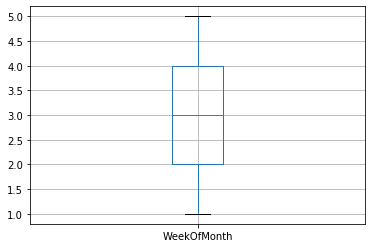

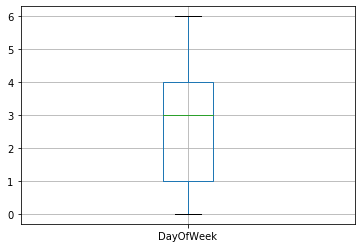

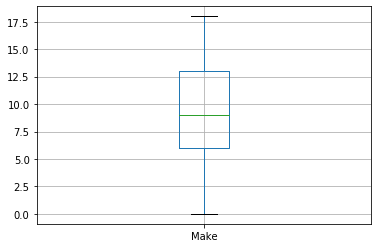

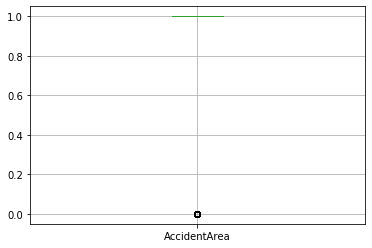

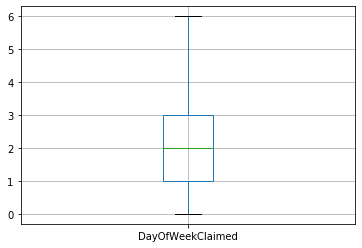

...

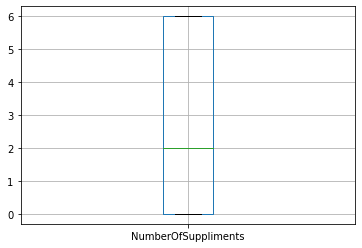

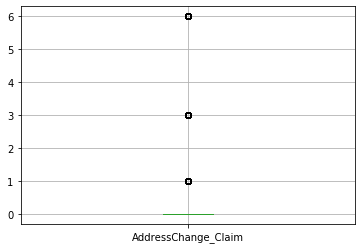

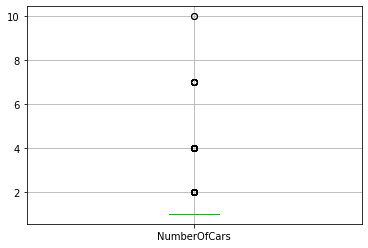

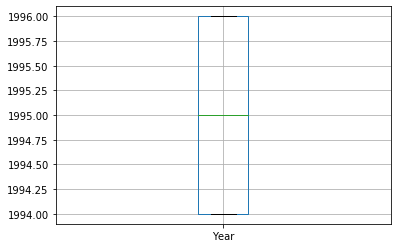

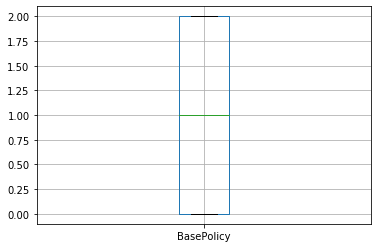

In [59]:
import seaborn as sns
for column in df.columns:
    #print(column)
    plt.figure()
    df.boxplot([column])

In [60]:
# Removing Outliers
df = df[df.Age<72]
df = df[df.VehiclePrice<50000]
df = df[df.VehiclePrice>10000]
df = df[df.Days_Policy_Accident<25]
df = df[df.AgeOfVehicle>3]

### Creating Test and Train data

In [61]:
y = df.FraudFound_P
x = df.drop('FraudFound_P', axis=1)

print('Target dimentions: ',y.shape)
print('Independent data dimentions: ',x.shape)

import sklearn.model_selection as model_selection
x_train, x_test, y_train, y_test = model_selection.train_test_split(x, y, train_size=0.7,test_size=0.3, random_state=101)

print('x_train dimentions: ',x_train.shape)
print('y_train  dimentions: ',y_train.shape)
print('x_test dimentions: ',x_test.shape)
print('y_test  dimentions: ',y_test.shape)

# As all dimentions are correct, we can move towards model creation, training and testing

Target dimentions:  (122,)
Independent data dimentions:  (122, 28)
x_train dimentions:  (85, 28)
y_train  dimentions:  (85,)
x_test dimentions:  (37, 28)
y_test  dimentions:  (37,)


# Machine Learning

### Creating the model

In [62]:
from sklearn.metrics import accuracy_score, log_loss
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC, LinearSVC, NuSVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, GradientBoostingClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis

classifiers = [
    KNeighborsClassifier(3),
    SVC(kernel="rbf", C=0.025, probability=True),
    #NuSVC(probability=True),
    DecisionTreeClassifier(),
    RandomForestClassifier(),
    AdaBoostClassifier(),
    GradientBoostingClassifier(),
    GaussianNB(),
    LinearDiscriminantAnalysis(),
    QuadraticDiscriminantAnalysis()
    ]

# Logging for Visual Comparison
log_cols=["Classifier", "Accuracy", "Log Loss"]
log = pd.DataFrame(columns=log_cols)

### Training and testing

In [63]:
for clf in classifiers:
    clf.fit(x_train, y_train)
    name = clf.__class__.__name__
    
    print("="*30)
    print(name)
    
    print('****Results****')
    train_predictions = clf.predict(x_test)
    acc = accuracy_score(y_test, train_predictions)
    print("Accuracy: {:.4%}".format(acc))
    
    train_predictions = clf.predict_proba(x_test)
    ll = log_loss(y_test, train_predictions)
    print("Log Loss: {}".format(ll))
    
    log_entry = pd.DataFrame([[name, acc*100, ll]], columns=log_cols)
    log = log.append(log_entry)
    
print("="*30)

KNeighborsClassifier
****Results****
Accuracy: 94.5946%
Log Loss: 1.9217534683881679
SVC
****Results****
Accuracy: 91.8919%
Log Loss: 0.26020511998180657
DecisionTreeClassifier
****Results****
Accuracy: 81.0811%
Log Loss: 6.534363101739859
RandomForestClassifier
****Results****
Accuracy: 91.8919%
Log Loss: 1.1160237514702802
AdaBoostClassifier
****Results****
Accuracy: 89.1892%
Log Loss: 0.34167549442964124

C:\Users\maila\Anaconda3\lib\site-packages\sklearn\svm\base.py:193: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)
C:\Users\maila\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)



GradientBoostingClassifier
****Results****
Accuracy: 86.4865%
Log Loss: 1.0488608233561625
GaussianNB
****Results****
Accuracy: 78.3784%
Log Loss: 2.387162250985926
LinearDiscriminantAnalysis
****Results****
Accuracy: 89.1892%
Log Loss: 0.7844659198479338
QuadraticDiscriminantAnalysis
****Results****
Accuracy: 89.1892%
Log Loss: 3.7339217724227773


C:\Users\maila\Anaconda3\lib\site-packages\sklearn\discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")
C:\Users\maila\Anaconda3\lib\site-packages\sklearn\discriminant_analysis.py:693: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


In [64]:
df.columns

Index(['WeekOfMonth', 'DayOfWeek', 'Make', 'AccidentArea', 'DayOfWeekClaimed',
       'MonthClaimed', 'WeekOfMonthClaimed', 'Sex', 'MaritalStatus', 'Age',
       'Fault', 'VehicleCategory', 'VehiclePrice', 'FraudFound_P', 'RepNumber',
       'Deductible', 'DriverRating', 'Days_Policy_Accident',
       'Days_Policy_Claim', 'PastNumberOfClaims', 'AgeOfVehicle',
       'PoliceReportFiled', 'WitnessPresent', 'AgentType',
       'NumberOfSuppliments', 'AddressChange_Claim', 'NumberOfCars', 'Year',
       'BasePolicy'],
      dtype='object')

In [65]:
df.Days_Policy_Accident.unique()

array([23, 12,  0,  4], dtype=int64)

In [66]:
df

,WeekOfMonth,DayOfWeek,Make,AccidentArea,DayOfWeekClaimed,MonthClaimed,WeekOfMonthClaimed,Sex,MaritalStatus,Age,...,PastNumberOfClaims,AgeOfVehicle,PoliceReportFiled,WitnessPresent,AgentType,NumberOfSuppliments,AddressChange_Claim,NumberOfCars,Year,BasePolicy
72,4,3,2,1,0,1,5,1,2,28.0,...,1,5,0,0,1,0,0,1,1994,1
216,1,4,17,1,1,6,3,0,1,61.0,...,0,8,1,0,1,0,0,1,1994,1
226,3,1,15,1,2,10,4,0,1,26.0,...,0,7,0,0,1,0,0,10,1994,1
550,3,0,2,1,1,2,4,0,1,64.0,...,0,8,0,0,1,0,0,1,1994,2
653,5,0,16,0,2,11,1,0,1,43.0,...,5,7,0,0,1,0,0,1,1994,0
659,4,3,13,1,4,3,3,0,1,37.0,...,3,7,0,0,1,0,0,1,1994,2
731,5,3,13,1,0,5,3,0,1,45.0,...,3,7,0,0,1,0,0,1,1994,2
804,1,5,9,1,3,11,4,0,1,32.0,...,1,6,0,0,1,0,0,1,1994,1
960,5,0,17,1,1,2,1,0,1,35.0,...,0,7,0,0,1,0,0,1,1994,2
1163,2,0,9,1,2,3,2,0,1,38.0,...,1,7,0,0,1,0,0,1,1994,0
